Experimental Dataset - 2D class - round2 class 93- 128x128

# Setup

In [1]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
from sklearn import metrics
import numpy as np
import torch
import h5py
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [2]:
print('we are here {}'.format(os.getcwd()))

we are here /gpfs/slac/cryo/fs1/g/ML/vaegan/analysis


In [3]:
KEYWORD      = 'exp_2Dclass_round2_class93_128x128'
KEYWORD_NINA = 'cryo_exp'
EPOCH_NUMBER = 180

In [4]:
DATASET_DIR     = '../datasets/exp/20181005-rib-TEM4/Extract/round2/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/round2/'
TRAINED_DIR     = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+'cryo_exp_128x128.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'class2D_round2_93_sort.h5'
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+KEYWORD_NINA+'_'+TRAINED_CHECKPOINT, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)

# Load dataset, encoder and decoder

In [5]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata =  h5py.File(TRAIN_METADATASET_PATH, 'r')
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))

dataset.shape (8278, 1, 128, 128) metadata.shape (8278, 180, 180)


In [6]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

Loading encoder...
exp_2Dclass_round2_class93_128x128/train_vae/epoch_180_checkpoint.pth
Found checkpoint. Getting: exp_2Dclass_round2_class93_128x128/train_vae/epoch_180_checkpoint.pth.


(8278, 3)

In [7]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

Loading decoder...
exp_2Dclass_round2_class93_128x128/train_vae/epoch_180_checkpoint.pth
Found checkpoint. Getting: exp_2Dclass_round2_class93_128x128/train_vae/epoch_180_checkpoint.pth.


(500, 1, 128, 128)

In [11]:
list(metadata.keys())

['_rlnamplitudecontrast',
 '_rlnanglepsi',
 '_rlnanglerot',
 '_rlnangletilt',
 '_rlnautopickfigureofmerit',
 '_rlnclassnumber',
 '_rlncoordinatex',
 '_rlncoordinatey',
 '_rlnctfbfactor',
 '_rlnctffigureofmerit',
 '_rlnctfmaxresolution',
 '_rlnctfscalefactor',
 '_rlndefocusangle',
 '_rlndefocusu',
 '_rlndefocusv',
 '_rlndetectorpixelsize',
 '_rlngroupnumber',
 '_rlnimagename',
 '_rlnloglikelicontribution',
 '_rlnmagnification',
 '_rlnmaxvalueprobdistribution',
 '_rlnmicrographname',
 '_rlnnormcorrection',
 '_rlnnrofsignificantsamples',
 '_rlnoriginx',
 '_rlnoriginy',
 '_rlnparticleselectzscore',
 '_rlnphaseshift',
 '_rlnsphericalaberration',
 '_rlnvoltage',
 'particles']

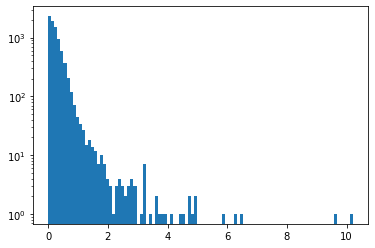

0.27756370142773734 0.3849067218255373


In [13]:
Zscore = np.array(metadata['_rlnparticleselectzscore'])
plt.hist(Zscore, bins=100, log=True)
plt.show()
print(np.mean(Zscore), np.std(Zscore))

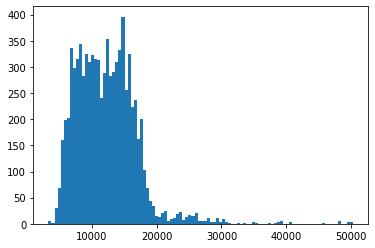

3333.739502 12189.916031496014 4691.042857648766


In [14]:
defocus = np.array(metadata['_rlndefocusu'])
plt.hist(defocus, bins=100, log=False)
plt.show()
print(np.min(defocus),np.mean(defocus), np.std(defocus))

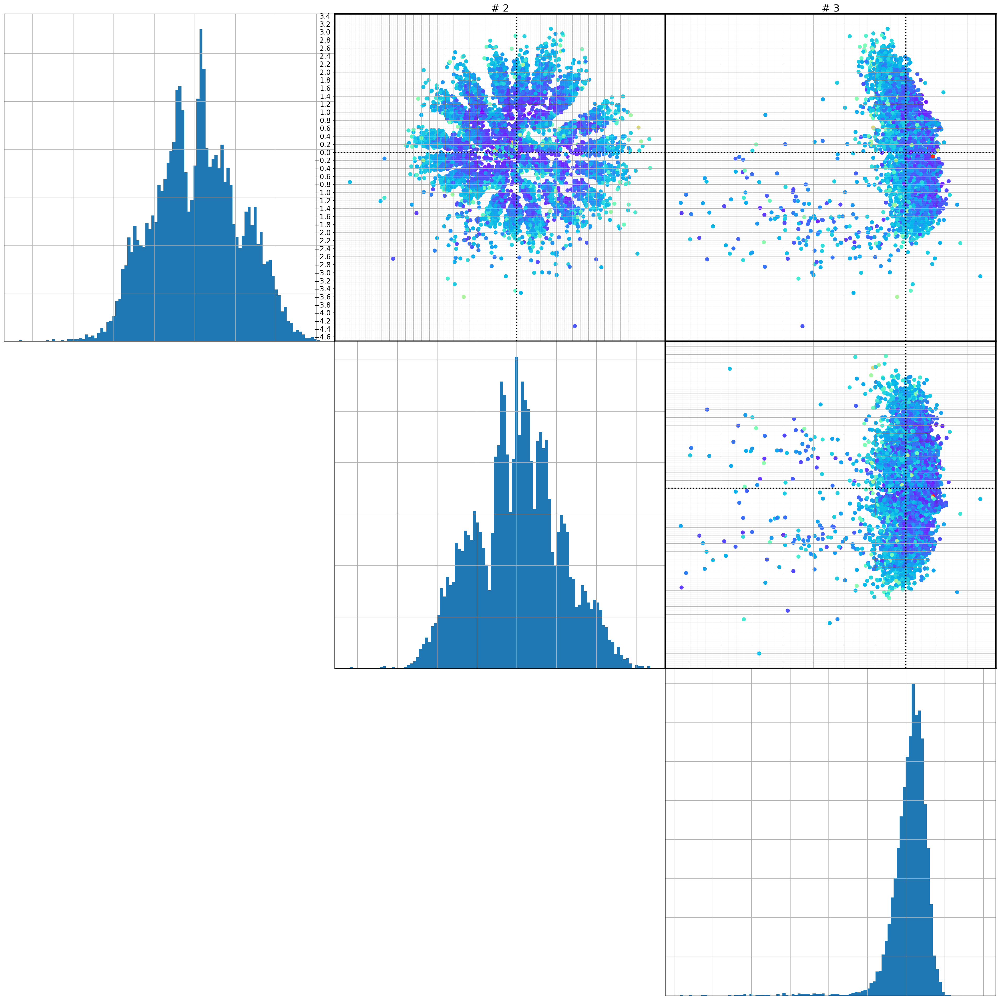

In [33]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_defocus_true')

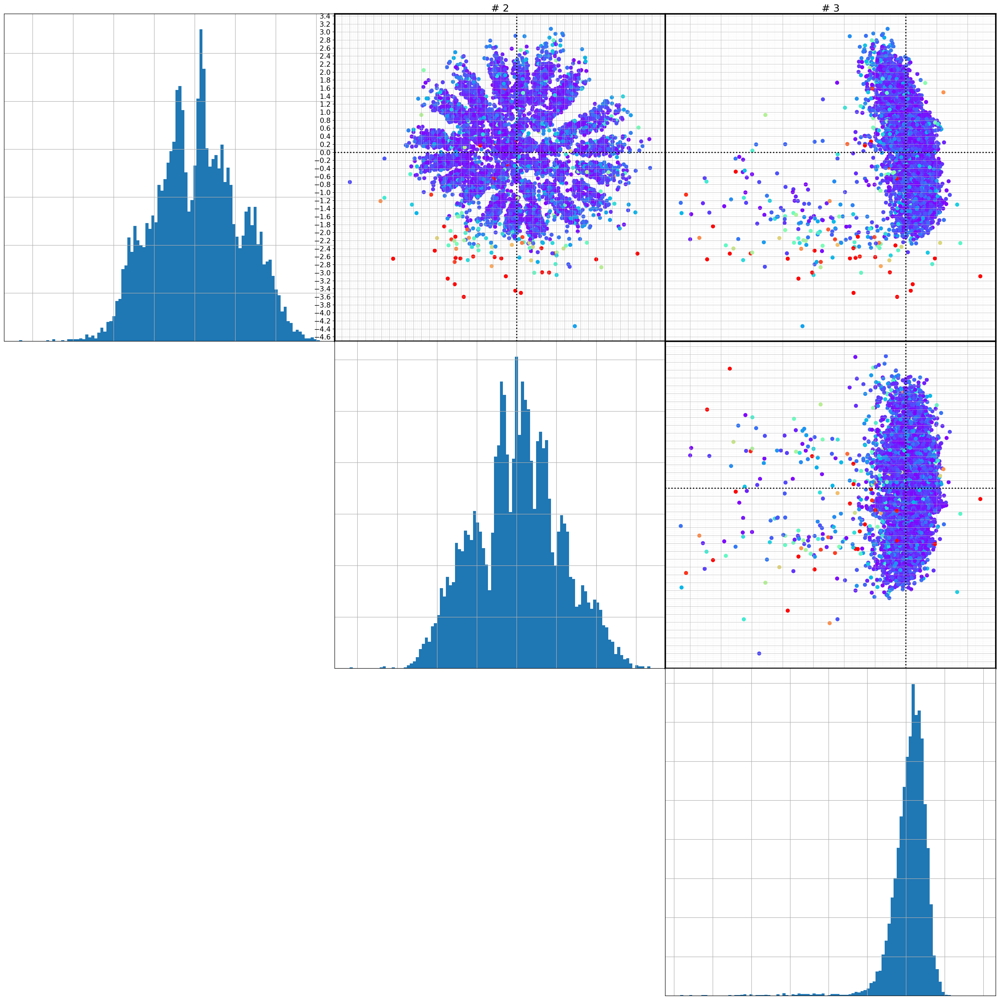

In [34]:
viz.biplots(mus,  n=3, show_histo=True, nbins=100, c=np.where(Zscore>3,3,Zscore),
            figname=KEYWORD+'/latent_space_Zscore')

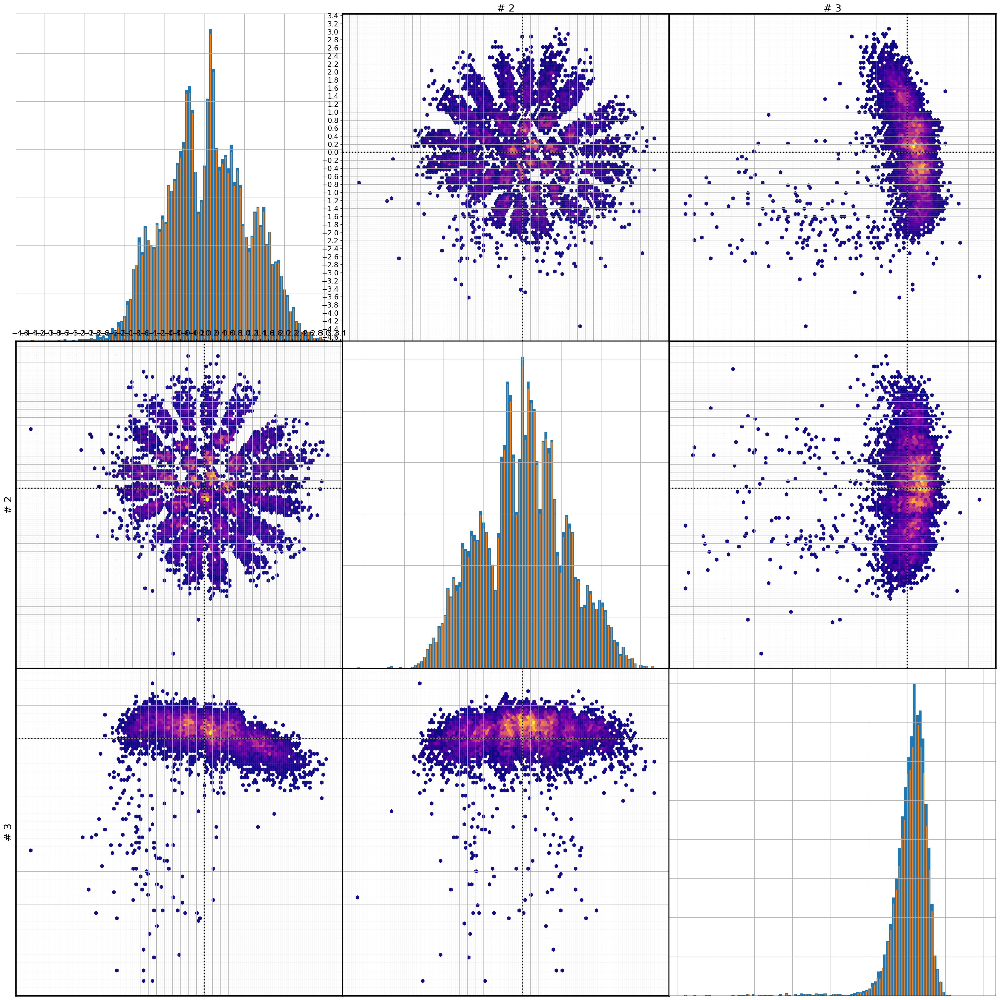

In [30]:
#viz.biplots(mus, prj2=mus[np.where(Zscore<1)], n=3, show_histo=True, nbins=100)#, c=np.where(Zscore>1,1,0))#3,Zscore))

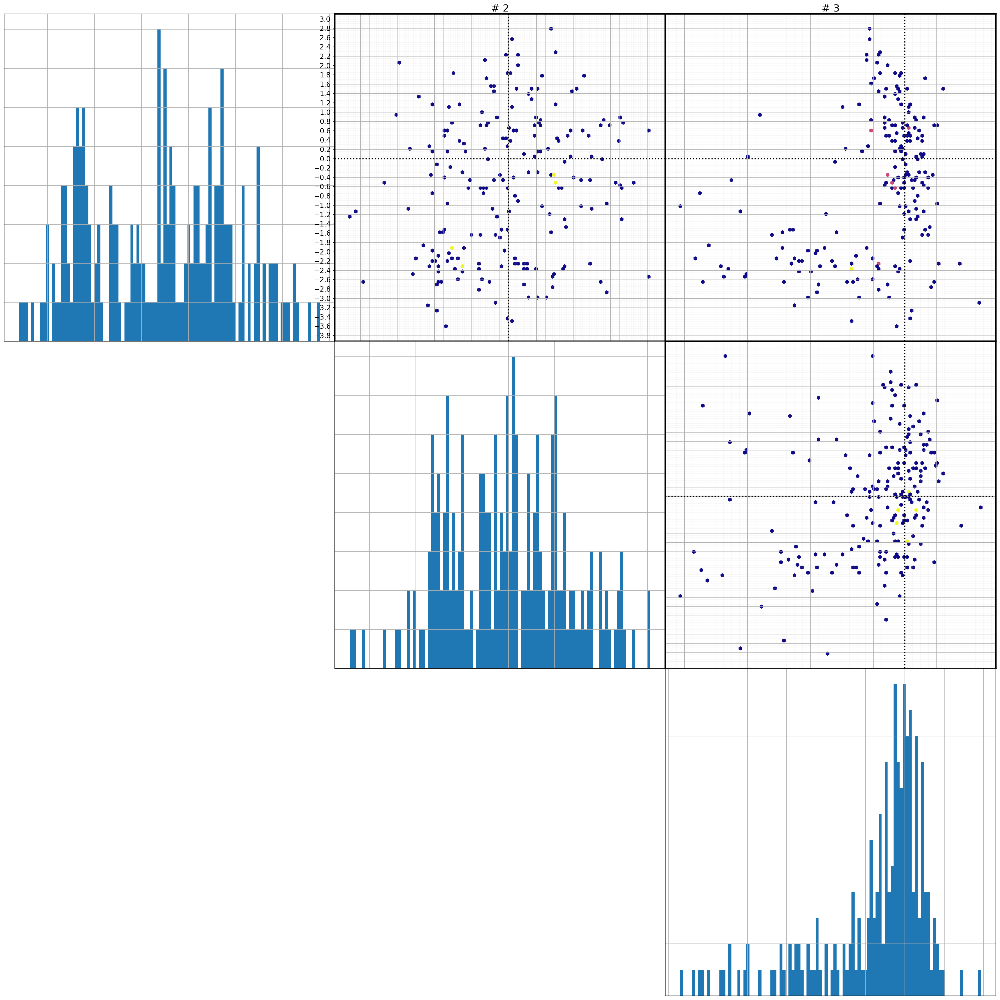

In [35]:
viz.biplots(mus[np.where(Zscore>1)], n=3, show_histo=True, nbins=100)#, c=np.where(Zscore>1,1,0))#3,Zscore))

# Visualize

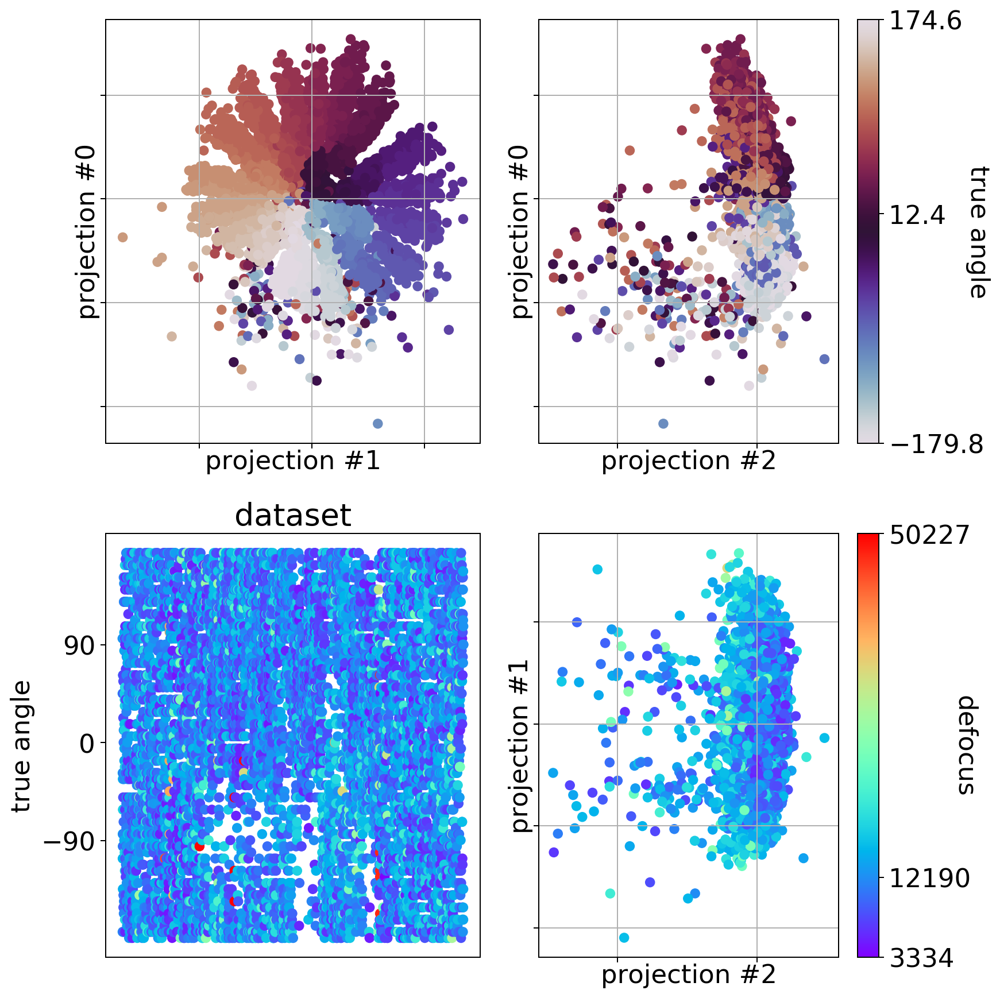

In [8]:
viz.show_latentspace(mus, metadata, 
                     label0='defocus', label1='true angle', 
                     figsize=10, dpi=180, fontsize=18,
                     figname=KEYWORD+'/latent_space.png')

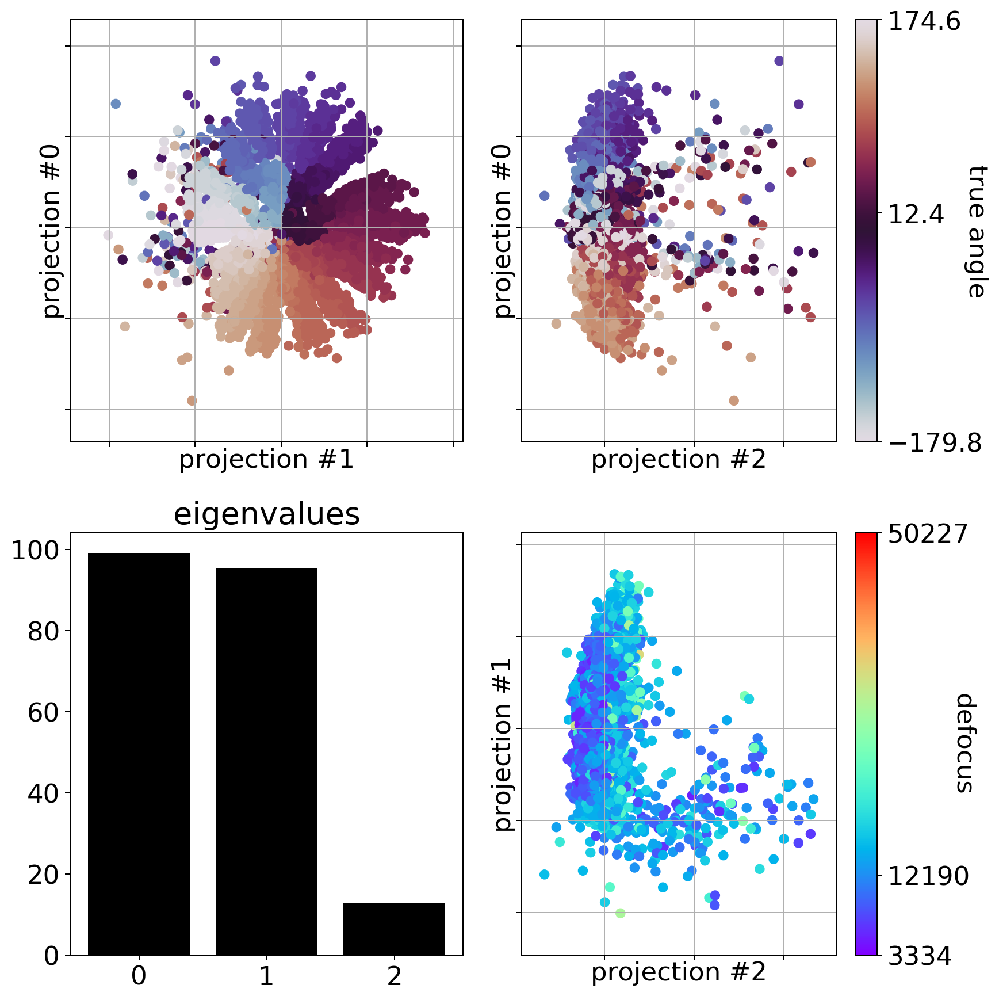

In [9]:
viz.show_latentspace(mus, metadata, 
                     label0='defocus', label1='true angle', 
                     figsize=10, dpi=180, fontsize=18,
                     do_pca=True,
                     figname=KEYWORD+'/pca_of_latent_space.png')

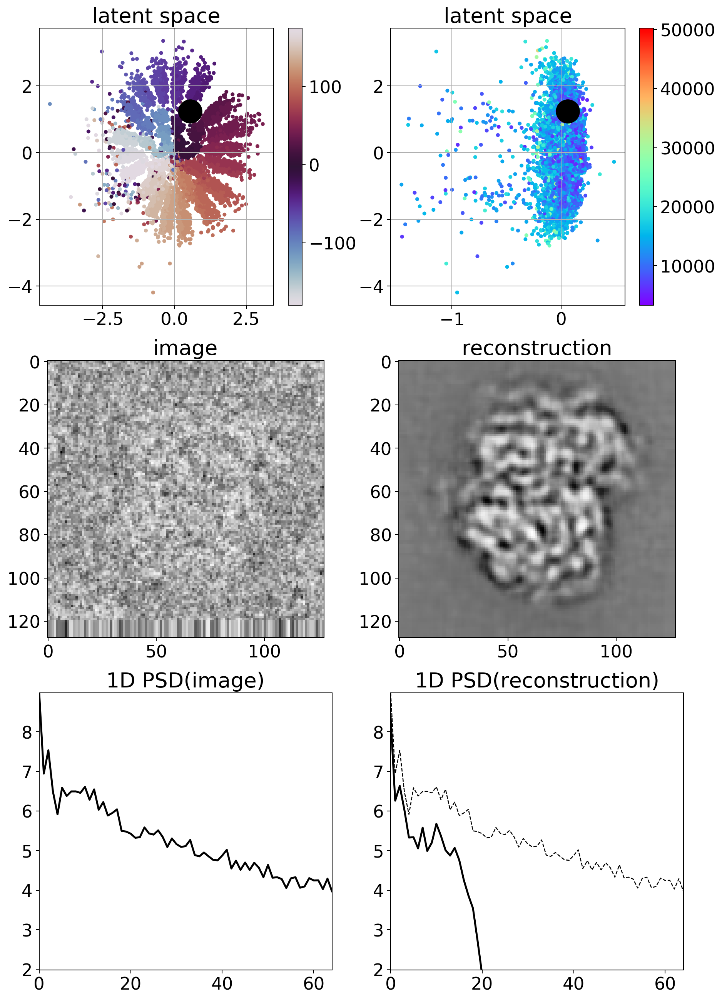

In [10]:
viz.visualize(dataset, recon,
              mus[:,0:2], mus[:,[2,1]],
              metadata[:,1], metadata[:,0],
              iframe=10,
              cmap1='twilight', cmap2='rainbow',
              show_3dpsd=False, show_1dpsd=True)

# Outlier prediction

In [31]:
Zscore_set=2

In [32]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print(positives.shape,negatives.shape)

(8222,) (56,)


AUC(robust_covar) = 0.890804722521458
AUC(isolation_forest) = 0.8879400215449839
AUC(local_outlier_detection) = 0.8472434583174063


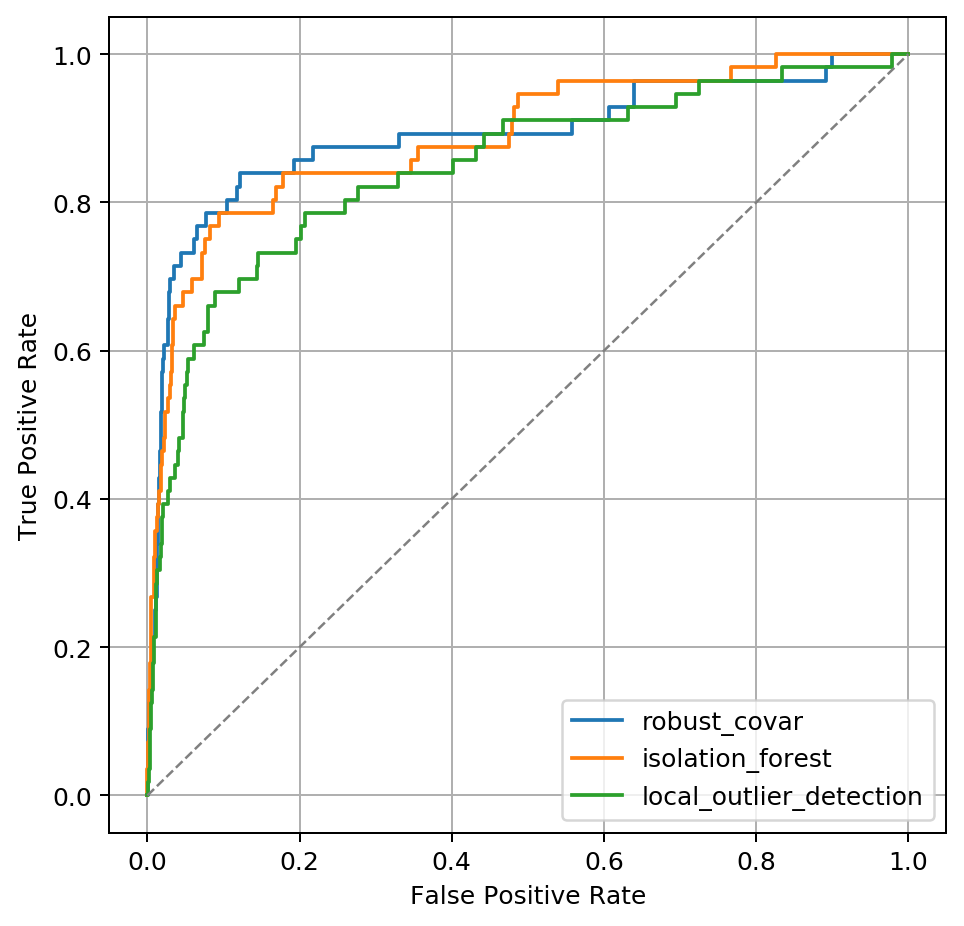

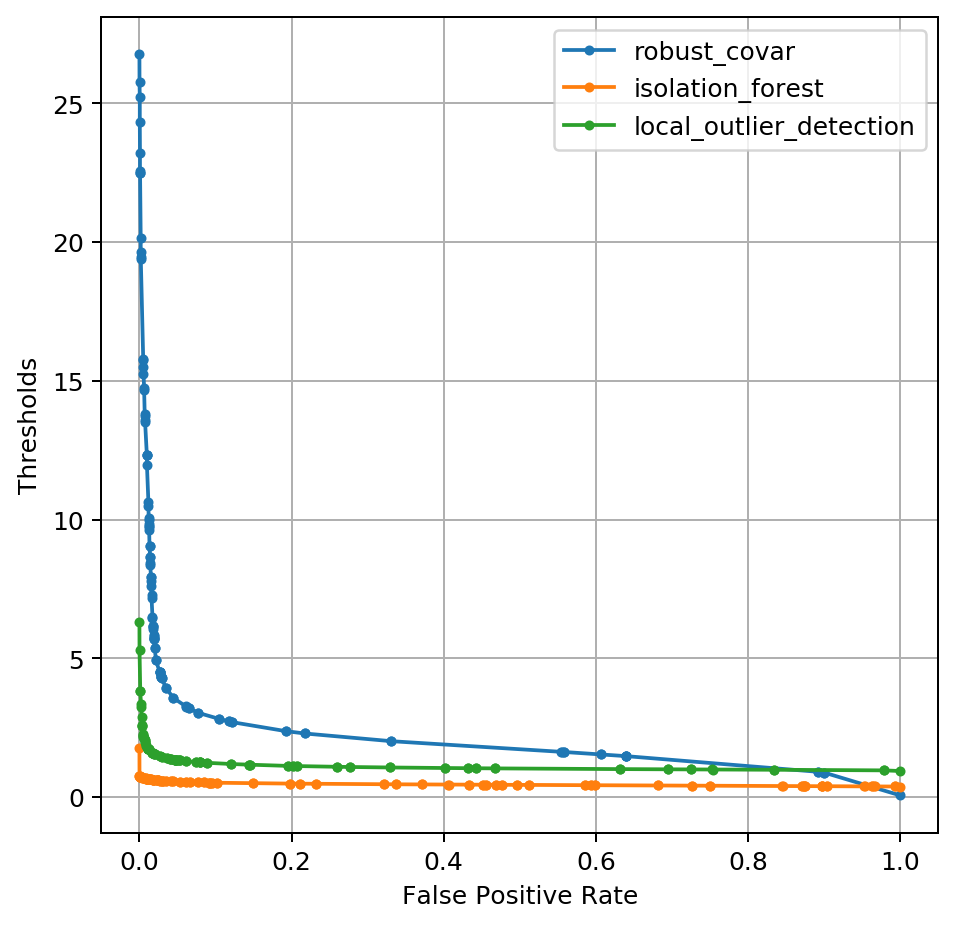

In [33]:
methods = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('Thresholds')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,thresholds, '.-')
    #print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
#plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_thresholds'+str(Zscore_set))

In [16]:
measure, offset, assignment = pred.outlier_measure(mus, method='robust_covar')

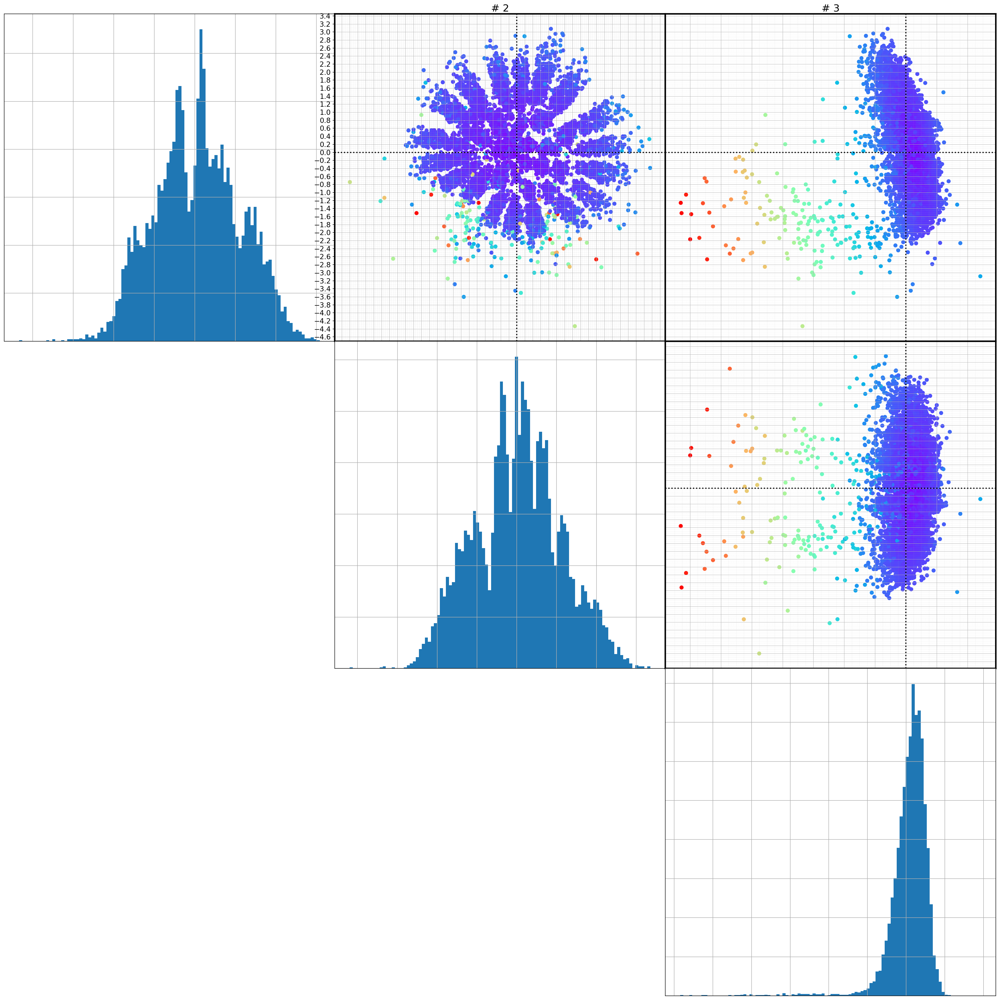

In [78]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=measure, figname=KEYWORD+'/latent_space_robust_covar')

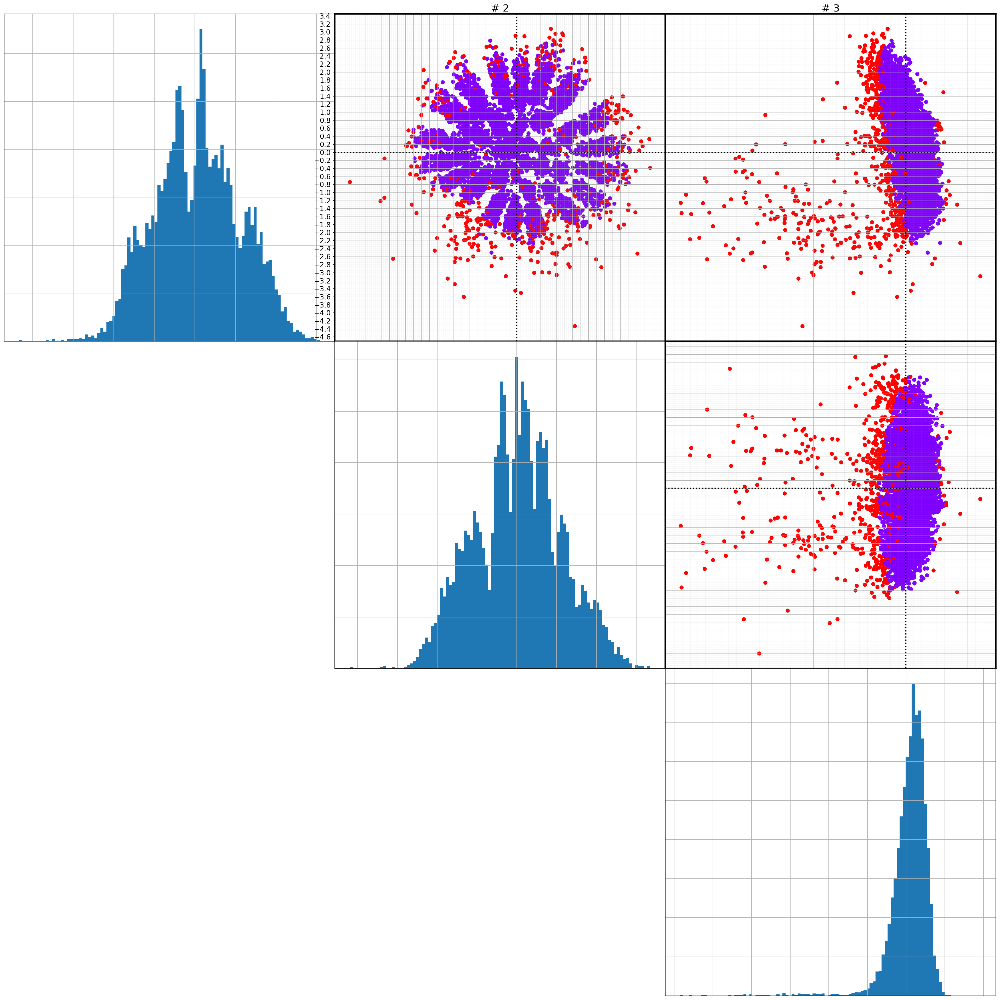

In [79]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=np.where(measure<3,0,1), figname=KEYWORD+'/latent_space_robust_covar_assigned')

In [17]:
mus_kept = mus[np.where(measure<3),:][0,...]
print(mus_kept.shape)
defocus_kept = np.array(metadata['_rlndefocusu'])[np.where(measure<3)]
print(defocus_kept.shape)
angle_kept = np.array(metadata['_rlnanglepsi'])[np.where(measure<3)]
print(angle_kept.shape)
Zscore_kept = np.array(metadata['_rlnparticleselectzscore'])[np.where(measure<3)]
print(Zscore_kept.shape)

(7573, 3)
(7573,)
(7573,)
(7573,)


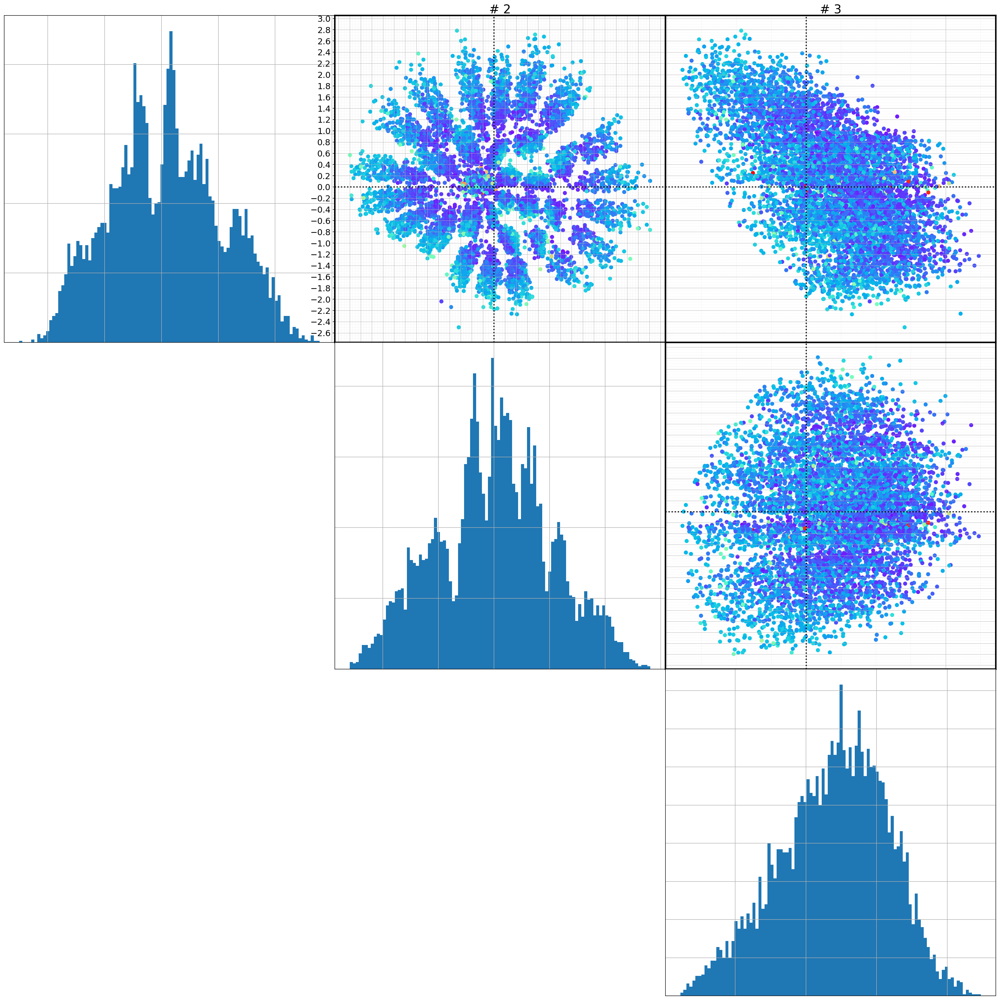

In [152]:
viz.biplots(mus_kept, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [18]:
U, L, Vt = np.linalg.svd(mus_kept, full_matrices=False)

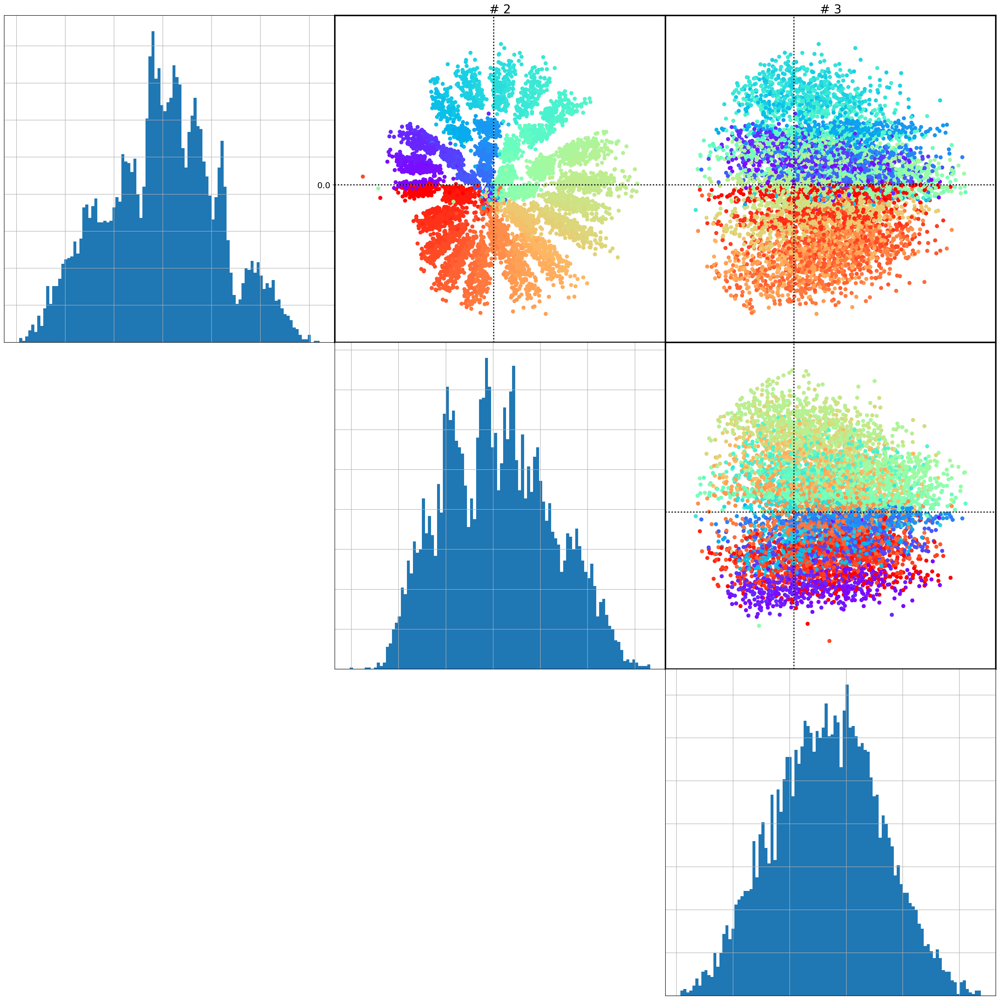

In [154]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=angle_kept)

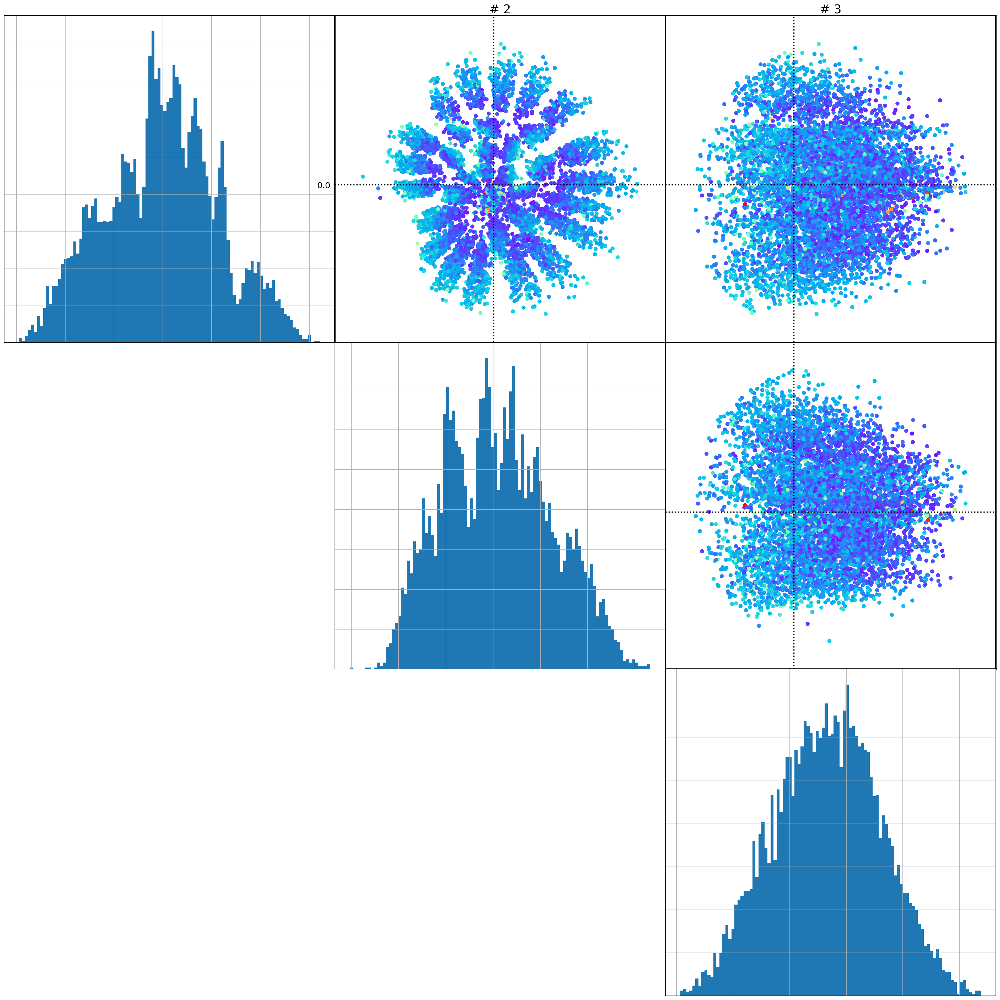

In [155]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [19]:
angle_true   = angle_kept + 180
defocus_true = defocus_kept

In [20]:
angle_pred, defocus_pred = pred.pred2d(mus_kept,  angle_true, defocus_true, 
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

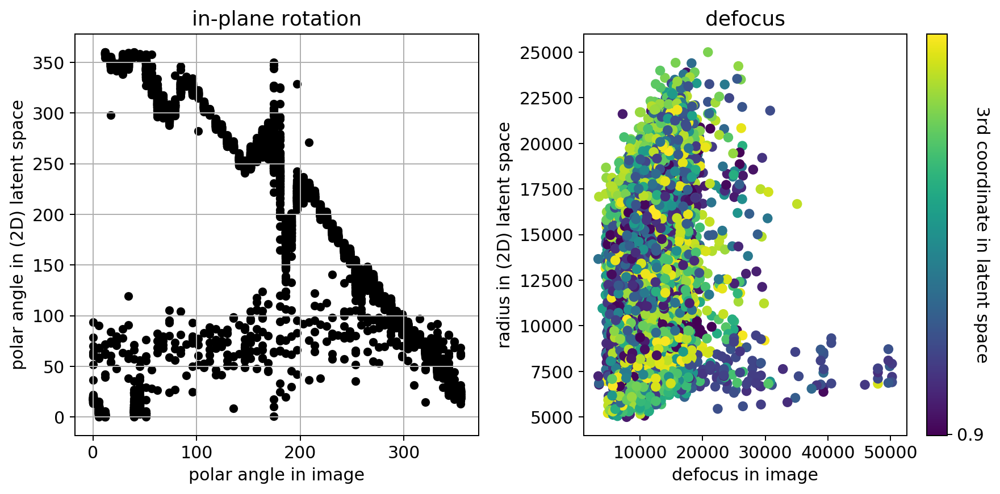

In [174]:
viz.plot_pred2d(angle_pred, defocus_pred, angle_true, defocus_true, metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse')

offset: -30 angle RMSE = 101.44954534962248
offset: -20 angle RMSE = 101.0933067318103
offset: -10 angle RMSE = 100.79214003778053
offset: 0 angle RMSE = 100.77664058984502
offset: 10 angle RMSE = 101.05001215903481
offset: 20 angle RMSE = 101.4456850800658
defocus RMSE = 6149.940426680479


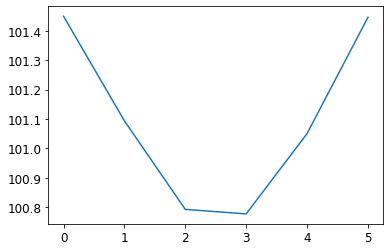

In [175]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-30,30,10))
plt.plot(angle_RMSE_list)

## Restricting the defocus range

In [21]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]

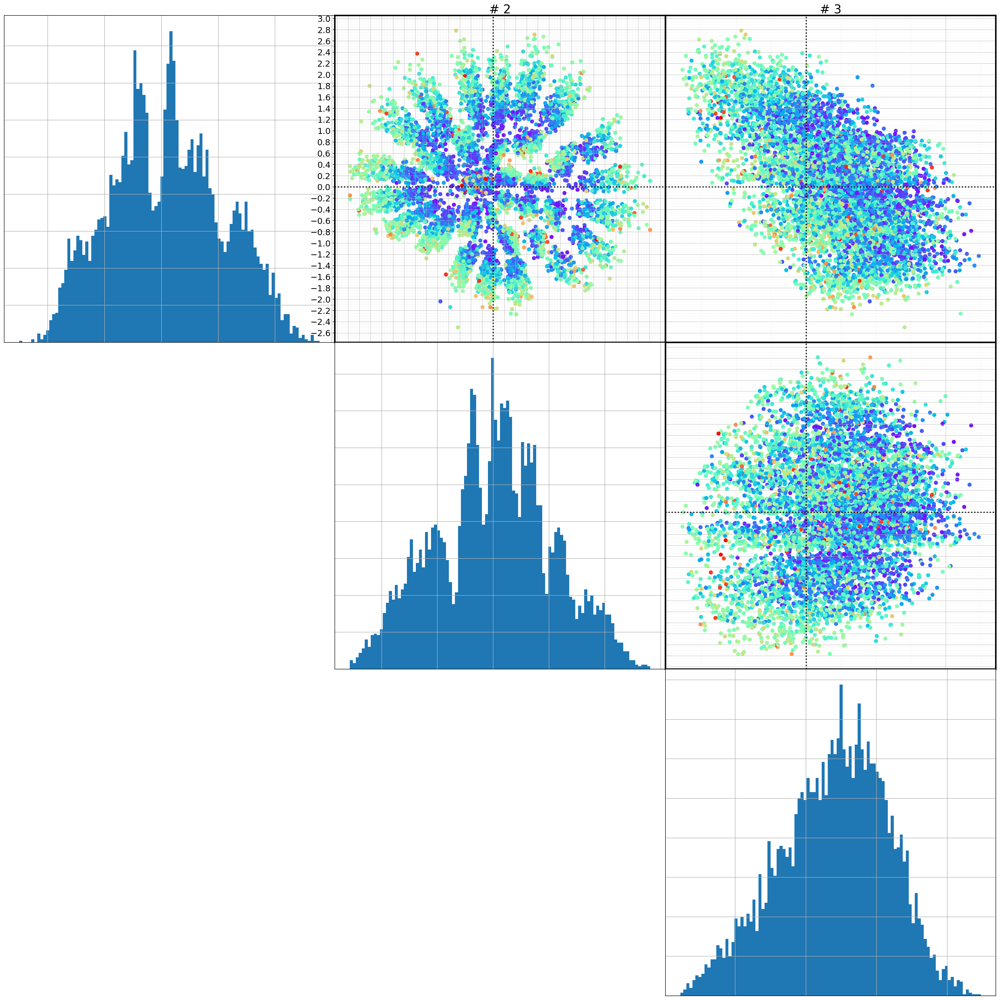

In [177]:
viz.biplots(mus_kept[index,:], n=3, show_histo=True, nbins=100, c=defocus_kept[index])

In [22]:
U_restricted, L_restricted, Vt_restricted = np.linalg.svd(mus_kept[index,:], full_matrices=False)

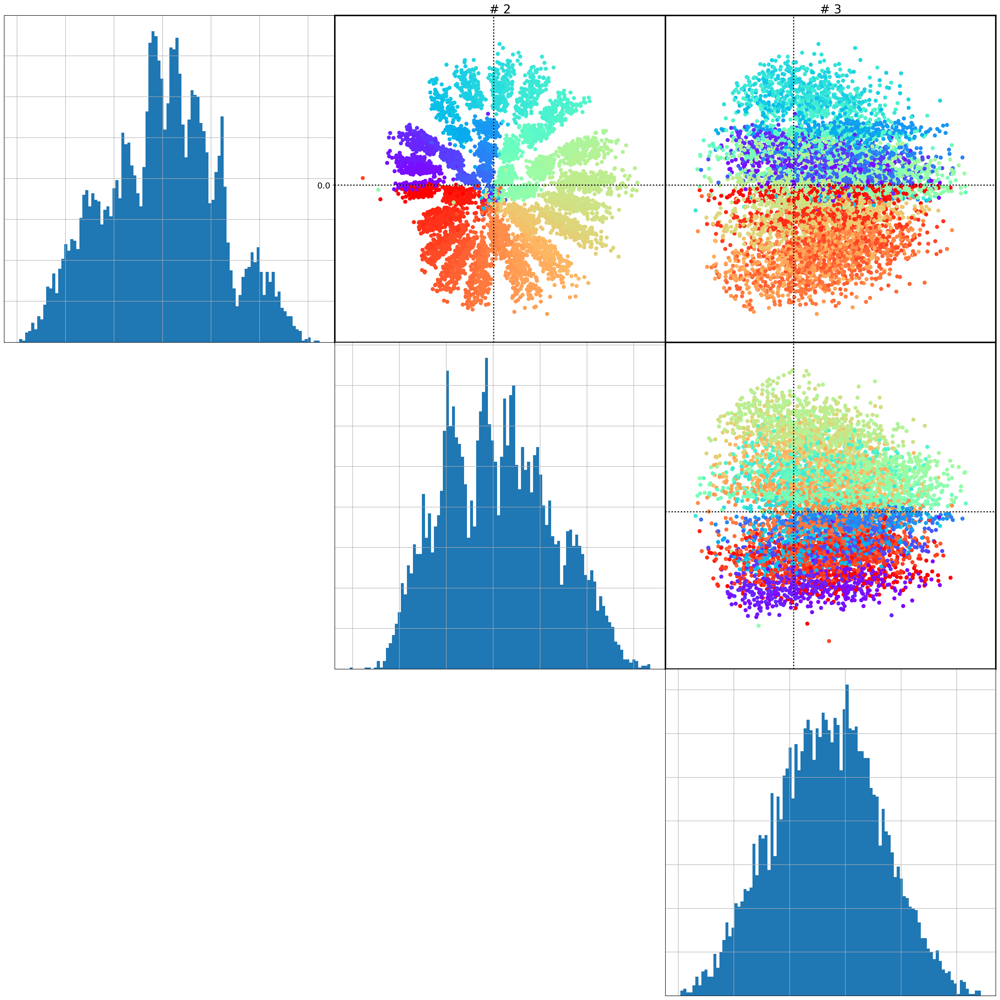

In [179]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=angle_kept[index])

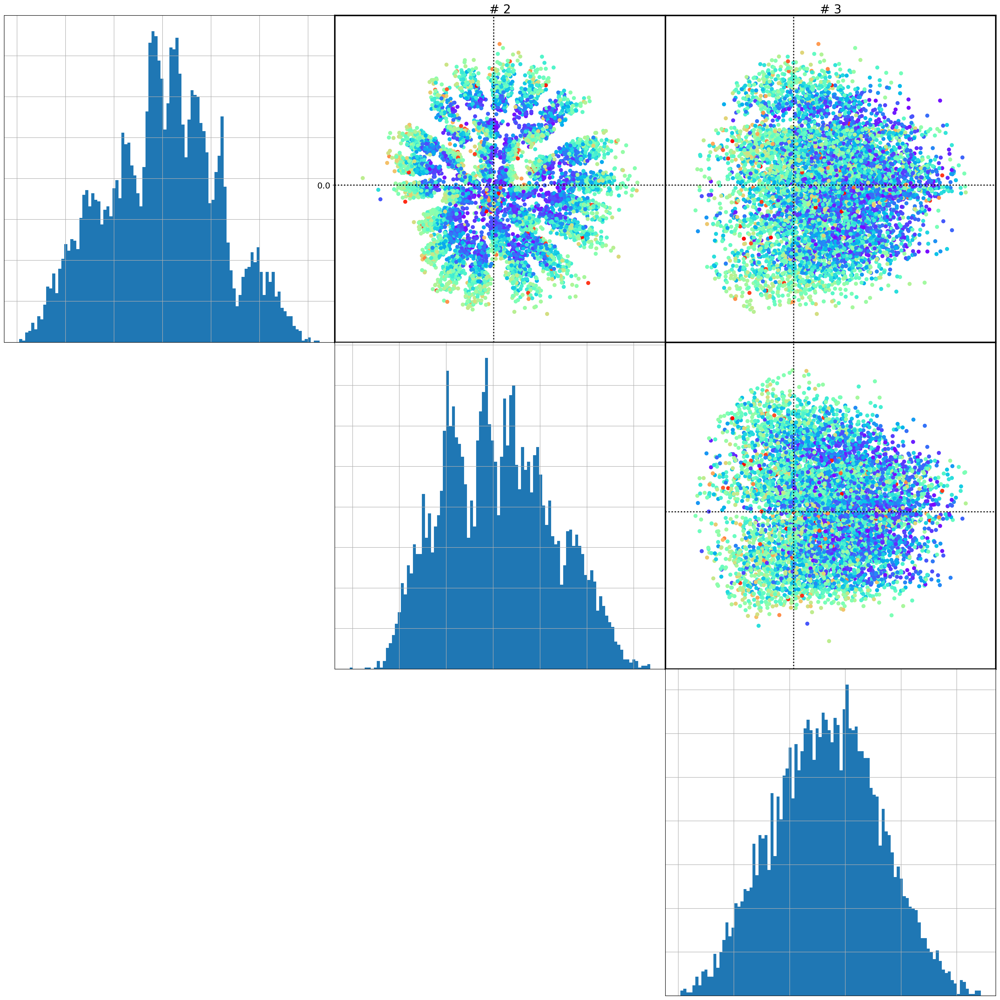

In [180]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=defocus_kept[index])

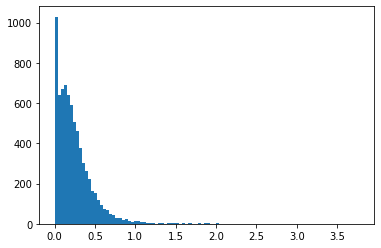

In [23]:
plt.hist(Zscore_kept[index], bins=100)
plt.show()

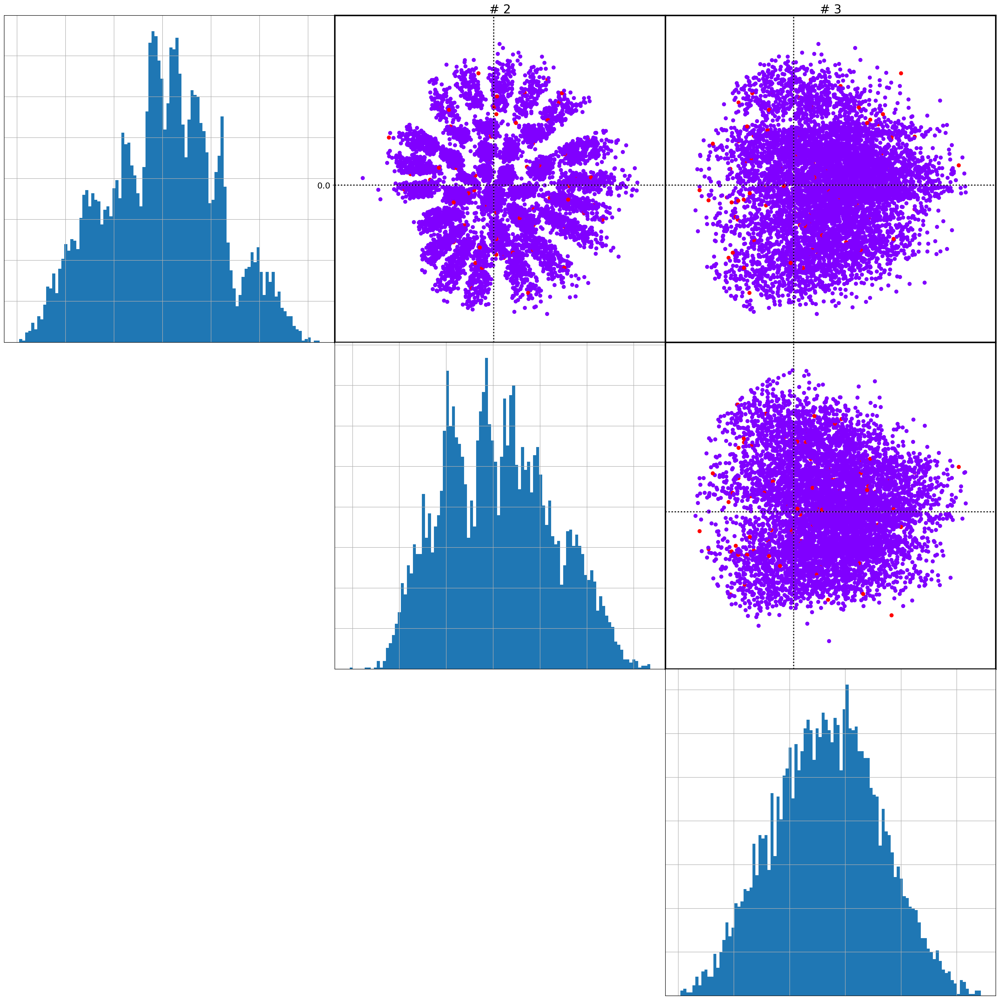

In [148]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=np.where(Zscore_kept[index]>1,1,0))

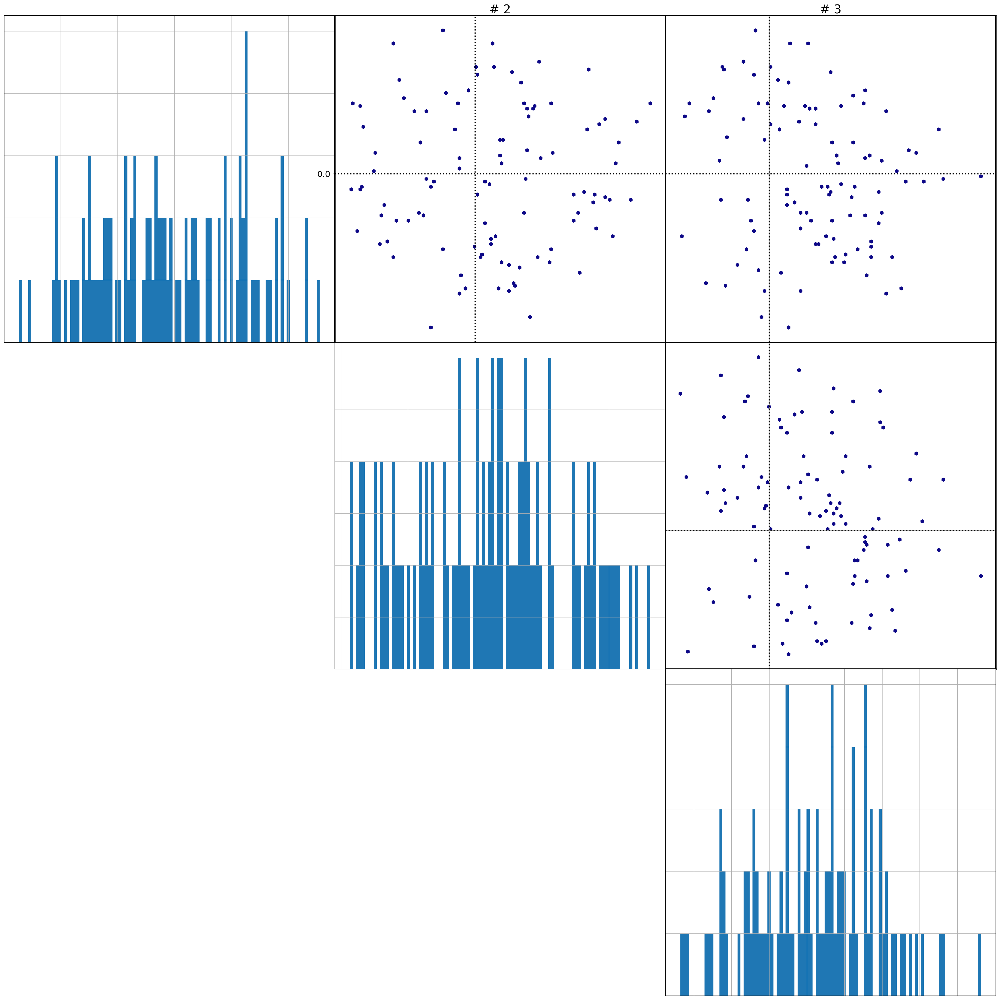

In [149]:
viz.biplots(U_restricted[np.where(Zscore_kept>1)], n=3, show_histo=True, nbins=100)#, c=np.where(Zscore_kept[index]>1,1,0))

In [24]:
angle_pred, defocus_pred = pred.pred2d(mus_kept[index,:],  angle_true[index], defocus_true[index], 
                                       angle_pred_sign=-1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

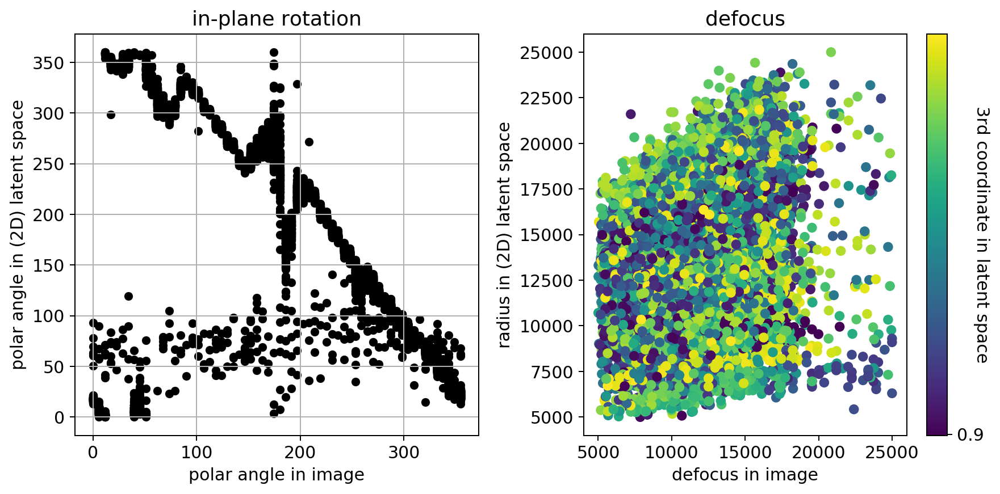

In [183]:
viz.plot_pred2d(angle_pred, defocus_pred, angle_true[index], defocus_true[index], metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

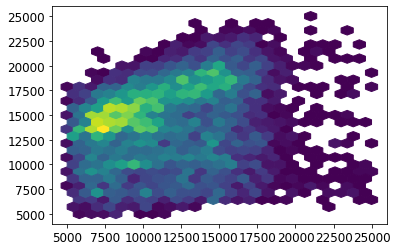

In [184]:
plt.hexbin(defocus_true[index],defocus_pred,gridsize=25,mincnt=1)

offset: 30 angle RMSE = 29.838922544712506
offset: 31 angle RMSE = 29.565474199784767
offset: 32 angle RMSE = 29.32347010425128
offset: 33 angle RMSE = 29.110762745947316
offset: 34 angle RMSE = 28.92824917588931
offset: 35 angle RMSE = 28.777765759971754
offset: 36 angle RMSE = 28.65820931666841
offset: 37 angle RMSE = 28.570495872209804
offset: 38 angle RMSE = 28.51751774704343
offset: 39 angle RMSE = 28.499550928079262
offset: 40 angle RMSE = 28.515051000545622
offset: 41 angle RMSE = 28.56376415523755
offset: 42 angle RMSE = 28.647044405509632
offset: 43 angle RMSE = 28.761209419993286
offset: 44 angle RMSE = 28.908390015299698
offset: 45 angle RMSE = 29.089186118194156
offset: 46 angle RMSE = 29.301383011087275
offset: 47 angle RMSE = 29.545919251666287
offset: 48 angle RMSE = 29.821999298283828
offset: 49 angle RMSE = 30.128756042246522
defocus RMSE = 5465.794000500299


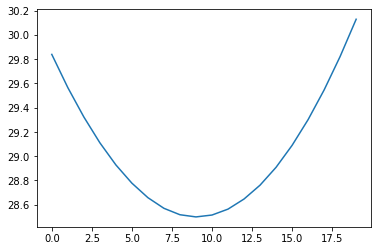

In [30]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(30,50,1))
plt.plot(angle_RMSE_list)